<a href="https://colab.research.google.com/github/Tharindu1527/tharindu1527/blob/code/CAT_and_DOG_validation.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
!wget --no-check-certificate https://storage.googleapis.com/mledu-datasets/cats_and_dogs_filtered.zip

--2024-02-24 16:21:42--  https://storage.googleapis.com/mledu-datasets/cats_and_dogs_filtered.zip
Resolving storage.googleapis.com (storage.googleapis.com)... 142.251.2.207, 74.125.137.207, 2607:f8b0:4023:c0d::cf, ...
Connecting to storage.googleapis.com (storage.googleapis.com)|142.251.2.207|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 68606236 (65M) [application/zip]
Saving to: ‘cats_and_dogs_filtered.zip’

cats_and_dogs_filte 100%[===================>]  65.43M   192MB/s    in 0.3s    

2024-02-24 16:21:43 (192 MB/s) - ‘cats_and_dogs_filtered.zip’ saved [68606236/68606236]



In [2]:
import zipfile

# Unzip the archive
local_zip = './cats_and_dogs_filtered.zip'
zip_ref = zipfile.ZipFile(local_zip, 'r')
zip_ref.extractall()

zip_ref.close()

In [4]:
import os

base_dir = 'cats_and_dogs_filtered'# actually this depicts our zip details

print("Contents of base directory:")
print(os.listdir(base_dir))# this depicts cats_and_dogs_filtered file's sub files--it has 3 sub files train, validation and vectorize.py file

print("\nContents of train directory:")
print(os.listdir(f'{base_dir}/train'))#train folder has2 sub folders as cats and dogs

print("\nContents of validation directory:")
print(os.listdir(f'{base_dir}/validation'))#validation folder has same 2 folders.

Contents of base directory:
['validation', 'vectorize.py', 'train']

Contents of train directory:
['dogs', 'cats']

Contents of validation directory:
['dogs', 'cats']


In [5]:
import os

train_dir = os.path.join(base_dir,'train')
validation_dir = os.path.join(base_dir,'validation')

#directory with training cats and dogs
train_cats_dir = os.path.join(train_dir,'cats')
train_dogs_dir = os.path.join(train_dir,'dogs')

#directory with validation cats and dogs pictures
validation_cats_dir = os.path.join(validation_dir,'cats')
validation_dogs_dir = os.path.join(validation_dir,'dogs')

In [6]:
train_cat_fnames = os.listdir(train_cats_dir)#listed all cats names
train_dog_fnames = os.listdir(train_dogs_dir)#listed all dogs names

validation_cat_fnames = os.listdir(validation_cats_dir)
validation_dog_fnames = os.listdir(validation_dogs_dir)

print(train_cat_fnames[:10])#first 10 number of cats names.
print(train_dog_fnames[:10])#first 10 number of dogs names.
print(validation_cat_fnames[:10])
print(validation_dog_fnames[:10])

['cat.594.jpg', 'cat.749.jpg', 'cat.734.jpg', 'cat.497.jpg', 'cat.376.jpg', 'cat.662.jpg', 'cat.246.jpg', 'cat.604.jpg', 'cat.463.jpg', 'cat.983.jpg']
['dog.985.jpg', 'dog.74.jpg', 'dog.478.jpg', 'dog.180.jpg', 'dog.584.jpg', 'dog.880.jpg', 'dog.748.jpg', 'dog.840.jpg', 'dog.873.jpg', 'dog.507.jpg']
['cat.2486.jpg', 'cat.2326.jpg', 'cat.2035.jpg', 'cat.2284.jpg', 'cat.2445.jpg', 'cat.2212.jpg', 'cat.2489.jpg', 'cat.2242.jpg', 'cat.2111.jpg', 'cat.2336.jpg']
['dog.2021.jpg', 'dog.2324.jpg', 'dog.2086.jpg', 'dog.2284.jpg', 'dog.2127.jpg', 'dog.2455.jpg', 'dog.2274.jpg', 'dog.2351.jpg', 'dog.2255.jpg', 'dog.2094.jpg']


In [7]:
#counting number of images in each category using   len()
print('Total Number of training cat images:',len(os.listdir(train_cats_dir)))
print('Total Number of training dogs images:',len(os.listdir(train_dogs_dir)))

print('Total Number of validation cat images:',len(os.listdir(validation_cats_dir)))
print('Total Number of validation dog images:',len(os.listdir(validation_dogs_dir)))

Total Number of training cat images: 1000
Total Number of training dogs images: 1000
Total Number of validation cat images: 500
Total Number of validation dog images: 500


In [8]:
%matplotlib inline
import matplotlib.image as mpimg
import matplotlib.pyplot as plt

#parameter for our graph--our output image is 4 by 4 configuration
nrows = 4
ncols = 4

pic_index = 0 #Index for iterating over images


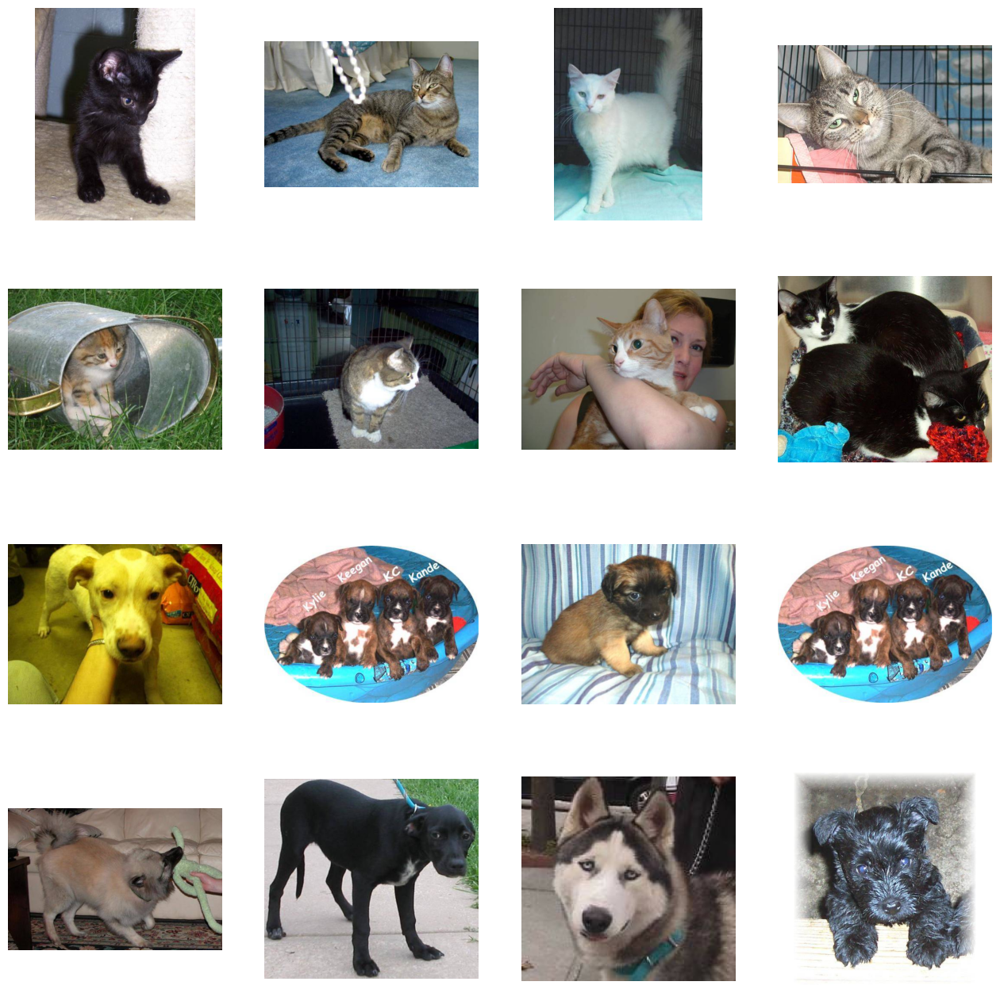

In [9]:
#set up matplotlib fig ,and size it to 4 by 4 pics
fig = plt.gcf()
fig.set_size_inches(ncols*4,nrows*4)
pic_index+=8

next_cat_pix =[os.path.join(train_cats_dir,fname)
                for fname in train_cat_fnames[pic_index-8:pic_index]
                ]
next_dog_pix =[os.path.join(train_dogs_dir,fname)
               for fname in train_dog_fnames[pic_index-8:pic_index]
              ]
for i, img_path in enumerate(next_cat_pix+next_dog_pix):
    #subplot --indeces start at 1
    sp = plt.subplot(nrows,ncols,i+1)
    sp.axis('off')#don't show axes and gridlines

    img = mpimg.imread(img_path)
    plt.imshow(img)

plt.show()

In [10]:
import tensorflow as tf
from tensorflow import keras

model = tf.keras.models.Sequential([

    #input shape is the desired size of the image 150*150 with 3 bytes color as RGB
    tf.keras.layers.Conv2D(16,(3,3),activation='relu',input_shape=(150,150,3)),
    tf.keras.layers.MaxPooling2D(2,2),
    tf.keras.layers.Conv2D(32,(3,3),activation='relu'),
    tf.keras.layers.MaxPooling2D(2,2),
    tf.keras.layers.Conv2D(64,(3,3),activation='relu'),
    tf.keras.layers.MaxPooling2D(2,2),

    #flatten the results to feed into a DNN
    tf.keras.layers.Flatten(),
    #512 neuron in 1st hidden layer
    tf.keras.layers.Dense(512, activation='relu'),
    # Only 1 output neuron. It will contain a value from 0-1 where 0 for 1 class ('cats') and 1 for the other ('dogs')
    tf.keras.layers.Dense(1, activation='sigmoid')
])

In [11]:
model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 148, 148, 16)      448       
                                                                 
 max_pooling2d (MaxPooling2  (None, 74, 74, 16)        0         
 D)                                                              
                                                                 
 conv2d_1 (Conv2D)           (None, 72, 72, 32)        4640      
                                                                 
 max_pooling2d_1 (MaxPoolin  (None, 36, 36, 32)        0         
 g2D)                                                            
                                                                 
 conv2d_2 (Conv2D)           (None, 34, 34, 64)        18496     
                                                                 
 max_pooling2d_2 (MaxPoolin  (None, 17, 17, 64)        0

In [12]:
from tensorflow.keras.optimizers import RMSprop

model.compile(optimizer=RMSprop(learning_rate=0.001),
              loss='binary_crossentropy',
              metrics = ['accuracy'])

In [13]:
from tensorflow.keras.preprocessing.image import ImageDataGenerator#this class use for rescalingn

#All images will be rescaled by 1/255
train_datagen = ImageDataGenerator(rescale = 1/255.0)
test_datagen = ImageDataGenerator(rescale = 1/255.0)

#----------------
#flow training images in batches of 20 using train_datagen generator
#----------------

train_generator = train_datagen.flow_from_directory(train_dir,
                                                    batch_size = 20,
                                                    class_mode = 'binary',
                                                    target_size = (150,150))

#----------------
#flow validation images in batches of 20 using train_datagen generator
#----------------
validation_generator =  test_datagen.flow_from_directory(validation_dir,
                                                         batch_size=20,
                                                         class_mode  = 'binary',
                                                         target_size = (150, 150))

Found 2000 images belonging to 2 classes.
Found 1000 images belonging to 2 classes.


In [14]:
#training
history= model.fit(
    train_generator,
    epochs=15,
    validation_data = validation_generator,
    verbose=2
)

Epoch 1/15
100/100 - 59s - loss: 0.7151 - accuracy: 0.5310 - val_loss: 0.6839 - val_accuracy: 0.5640 - 59s/epoch - 585ms/step
Epoch 2/15
100/100 - 57s - loss: 0.6451 - accuracy: 0.6315 - val_loss: 0.5908 - val_accuracy: 0.7010 - 57s/epoch - 569ms/step
Epoch 3/15
100/100 - 56s - loss: 0.5757 - accuracy: 0.7080 - val_loss: 0.5508 - val_accuracy: 0.7270 - 56s/epoch - 561ms/step
Epoch 4/15
100/100 - 55s - loss: 0.5307 - accuracy: 0.7420 - val_loss: 0.5567 - val_accuracy: 0.7200 - 55s/epoch - 550ms/step
Epoch 5/15
100/100 - 51s - loss: 0.4633 - accuracy: 0.7740 - val_loss: 0.5449 - val_accuracy: 0.7240 - 51s/epoch - 511ms/step
Epoch 6/15
100/100 - 51s - loss: 0.4048 - accuracy: 0.8105 - val_loss: 0.6100 - val_accuracy: 0.7110 - 51s/epoch - 514ms/step
Epoch 7/15
100/100 - 57s - loss: 0.3431 - accuracy: 0.8410 - val_loss: 0.5911 - val_accuracy: 0.7330 - 57s/epoch - 566ms/step
Epoch 8/15
100/100 - 52s - loss: 0.2635 - accuracy: 0.8885 - val_loss: 0.9353 - val_accuracy: 0.6840 - 52s/epoch - 518

In [ ]:
#MODEL PREDICTION

In [18]:
import numpy as np
from google.colab import files
from tensorflow.keras.utils import load_img,img_to_array

uploaded = files.upload()

for fn in uploaded.keys():
    #predicting images
    path='/content/'+fn
    img=load_img(path,target_size=(150,150))

x=img_to_array(img)
x /= 255
x=np.expand_dims(x, axis=0)
images = np.vstack([x])

classes = model.predict(images, batch_size=10)

print(classes[0])

if classes[0]>0.5:
    print(fn + " is a dog")
else:
    print(fn + " is a cat")

Saving dog.10.jpg to dog.10.jpg
1/1 [==============================] - 0s 27ms/step
[0.99999744]
dog.10.jpg is a dog


1/1 [==============================] - 0s 101ms/step


<ipython-input-25-4207b2dd8c93>:47: RuntimeWarning: invalid value encountered in divide
  x  /=  x.std()
<ipython-input-25-4207b2dd8c93>:50: RuntimeWarning: invalid value encountered in cast
  x   =   np.clip(x, 0, 255).astype('uint8')
<ipython-input-25-4207b2dd8c93>:56: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(figsize=(scale * n_features, scale))


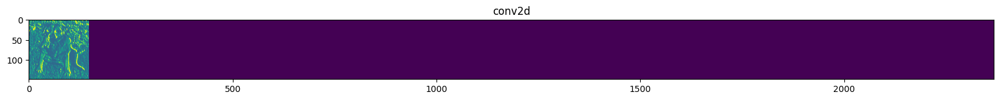

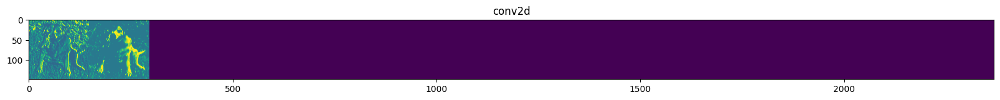

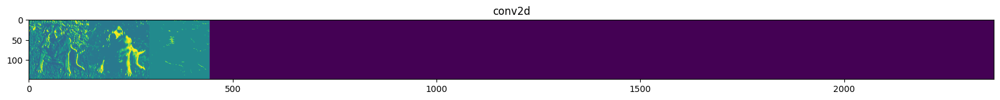

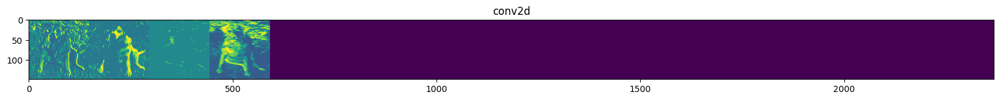

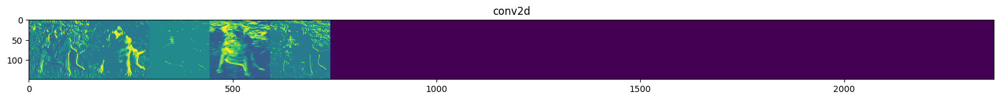

...

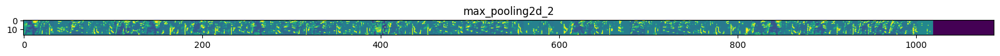

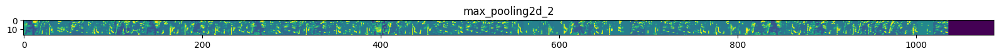

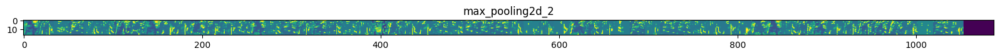

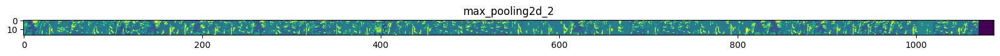

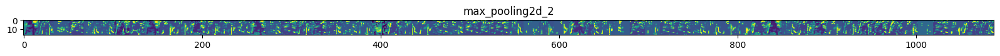

In [25]:
import numpy as np
import random
from tensorflow.keras.utils import img_to_array, load_img
#this is new model that will take image as input and we can get output
# intermediate representations for all layers in the previous model
successive_outputs = [layer.output for layer in model.layers]
visualization_model = tf.keras.Model(inputs = model.input, outputs = successive_outputs)

#prepare a random input image from the training set and when i use validation images for that we can't get output properly
cat_img_files = [os.path.join(train_cats_dir, f) for f in train_cat_fnames]
dog_img_files = [os.path.join(train_dogs_dir,f) for f in train_dog_fnames]
img_path = random.choice(cat_img_files + dog_img_files)
img = load_img(img_path, target_size=(150,150)) #this is a pil image using python pillow library
x =img_to_array(img)  #using numpy array  with shape(150,150,3)--that mean 150*150 and RGB color
x =x.reshape((1,) +x.shape) #using numpy array with shape (1,150,150,3)--normlization

#Scale for normlization
x/=255.0

# Run the image through the network, thus obtaining all
# intermediate representations for this image.
successive_feature_maps = visualization_model.predict(x)

#these are the namees of the layers,that use for as part of plot
layer_names = [layer.name for layer in model.layers]

#Display the represemntation
for layer_name, feature_map in zip(layer_names, successive_feature_maps):

  if len(feature_map.shape) == 4:

    #-------------------------------------------
    # Just do this for the conv / maxpool layers, not the fully-connected layers
    #-------------------------------------------
    n_features = feature_map.shape[-1]#number of features in the feature map
    size       = feature_map.shape[1] #feature map shape (1, size,size,n_features)

    #title the image in the matrix
    display_grid =np.zeros((size, size*n_features))

    #-------------------------------------------------
    # Postprocess the feature to be visually palatable
    #-------------------------------------------------
    for i in range(n_features):
      x   =   feature_map[0,:,:,i]
      x  -=  x.mean()
      x  /=  x.std()
      x  *=  64
      x  +=  128
      x   =   np.clip(x, 0, 255).astype('uint8')
      display_grid[:, i*size : (i+1)* size] = x #Tile each filter into a horizontal grid

      #Display the grid

      scale = 20./n_features
      plt.figure(figsize=(scale * n_features, scale))
      plt.title(layer_name)
      plt.grid(False)
      plt.imshow(display_grid,aspect='auto',cmap='viridis')





Text(0.5, 1.0, 'training and validation loss')

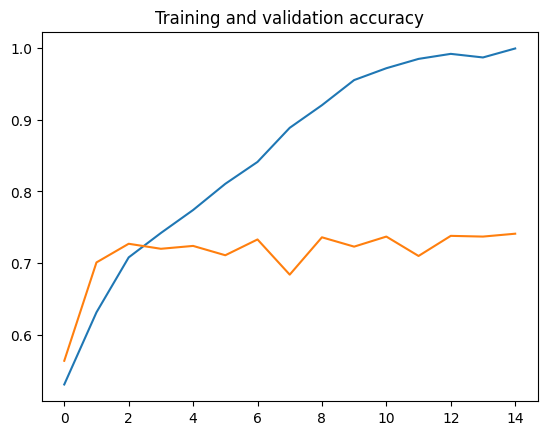

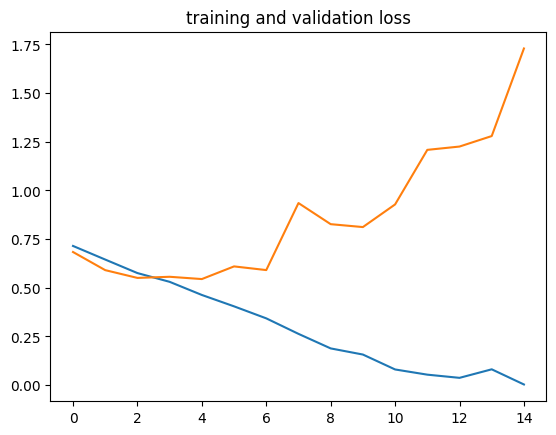

In [26]:
#Retrive a list of list results on training and set data
#sets for each training epoch

acc       = history.history['accuracy']
val_acc   = history.history['val_accuracy']
loss      = history.history['loss']
val_loss  = history.history['val_loss']

epochs    =range(len(acc))#Get number of echos

#plot training and validation accuaracy per epoch

plt.plot(epochs, acc)
plt.plot(epochs, val_acc)
plt.title('Training and validation accuracy')
plt.figure()

#plot training and validation loss per epoch

plt.plot(epochs, loss)
plt.plot(epochs, val_loss)
plt.title('training and validation loss')

In [ ]:
import os,signal

os.kill(os.getpid(),signal.SIGKILL)